# **Efficient frontier**

In [2]:
import numpy as np
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn

In [3]:
# function to download historical data
def get_data(tickers, start, end):
    data = yf.download(tickers, start=start, end=end)['Adj Close']
    returns = data.pct_change().dropna()
    return returns

# asset tickers, start & end date
tickers = ['NVDA', 'MSFT', 'AAPL', 'GOOGL', 'GOOG', 'AMZN', 'V', 'TSLA', 'META', 'ABBV', 'MA', 'LLY', 'UNH', 'ABT', 'BAC', 'CRM', 'KO', 'UNP', 'COST', 'CSCO', 'ADBE', 'QCOM', 'PEP', 'ADP', 'MRK', 'AMD', 'ACN', 'SPGI', 'SHW', 'T', 'DHR', 'MCO', 'BLK', 'REGN', 'MDLZ', 'DE', 'NOW', 'PLD', 'MCD', 'LRCX', 'MU', 'AMGN', 'LOW', 'PG', 'WM', 'NKE', 'KLAC', 'GILD', 'BSX', 'BMY', 'UPS', 'JPM', 'HD', 'CL', 'VRSK', 'TJX', 'C', 'TMUS', 'INTU', 'AXP']
# PYPL, UBER, HPE
start_date = '2014-01-01'
end_date = '2024-10-01'

# Download data & get daily returns
returns = get_data(tickers, start=start_date, end=end_date)

[*********************100%%**********************]  60 of 60 completed


In [4]:
num_tickers = len(tickers)
num_tickers
returns.head()

Ticker,AAPL,ABBV,ABT,ACN,ADBE,ADP,AMD,AMGN,AMZN,AXP,BAC,BLK,BMY,BSX,C,CL,COST,CRM,CSCO,DE,DHR,GILD,GOOG,GOOGL,HD,INTU,JPM,KLAC,KO,LLY,LOW,LRCX,MA,MCD,MCO,MDLZ,META,MRK,MSFT,MU,NKE,NOW,NVDA,PEP,PG,PLD,QCOM,REGN,SHW,SPGI,T,TJX,TMUS,TSLA,UNH,UNP,UPS,V,VRSK,WM
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2014-01-03,-0.021966,0.006156,0.010725,0.003328,-0.002193,0.010894,0.012658,-0.011485,-0.003845,0.003242,0.019255,0.004380,0.011096,0.001679,0.021619,-0.001867,-0.004414,0.004739,-0.000909,0.004432,0.001439,-0.011833,-0.007295,-0.007295,-0.001585,-0.001844,0.007730,0.001420,-0.004918,0.007294,-0.009911,-0.000186,-0.003992,0.001348,0.006596,-0.001723,-0.002742,0.004849,-0.006728,-0.031856,-0.002684,-0.009158,-0.011980,0.001705,-0.001117,0.008940,-0.005865,-0.010343,0.002138,-0.002701,-0.004293,0.001890,-0.032664,-0.003598,0.007108,-0.001556,-0.002226,0.000679,0.000154,-0.000226
2014-01-06,0.005453,-0.036520,0.013199,-0.010565,-0.017579,-0.011396,0.032500,-0.008648,-0.007088,-0.000446,0.015235,-0.000318,-0.003973,0.033529,0.007678,-0.000623,-0.007588,-0.016147,0.001364,-0.008273,-0.008751,-0.014532,0.011149,0.011149,-0.009647,-0.000791,0.005796,-0.017488,-0.004696,0.008415,-0.014096,-0.012792,-0.004959,-0.007147,0.000000,-0.006331,0.048387,0.000201,-0.021133,-0.014306,-0.007690,0.009967,0.013402,0.000487,0.002362,0.004296,-0.002607,-0.010635,-0.000602,-0.002063,0.004598,-0.010849,0.037175,-0.017117,-0.011451,-0.010129,-0.012998,-0.006014,-0.022724,-0.009731
2014-01-07,-0.007152,0.001985,-0.007663,0.012168,0.014625,0.012154,0.012106,0.025996,0.011178,-0.003790,-0.009604,0.009202,-0.001520,0.008921,0.006876,0.000935,-0.004639,0.013277,0.013630,0.004449,0.008301,-0.006281,0.019278,0.019278,0.004932,0.017428,-0.011525,-0.000481,0.002980,-0.006598,0.002486,0.012394,0.013929,0.005530,0.000771,0.008109,0.012587,0.007438,0.007750,0.051282,0.000775,0.036784,0.016373,0.014584,0.009673,0.008823,0.007428,0.019378,0.026931,0.008788,-0.000286,0.004292,-0.007766,0.016054,0.030577,0.008840,0.003243,0.007642,-0.000628,0.007313
2014-01-08,0.006333,-0.002575,0.009009,0.007728,-0.001187,-0.005323,0.000000,-0.004724,0.009773,0.003142,0.004849,-0.000316,0.016363,0.028135,0.011628,-0.010280,-0.015622,0.036215,-0.000896,-0.010741,0.000522,0.009344,0.002081,0.002081,0.005276,-0.005594,0.009430,-0.000482,-0.011142,-0.001563,0.003514,0.005009,-0.000299,-0.010064,-0.020670,0.000287,0.005352,-0.006386,-0.017852,0.098481,-0.005162,0.001904,0.013631,-0.002875,-0.014493,-0.001325,0.006008,-0.002080,0.011034,-0.001537,-0.002941,0.005065,0.002709,0.012855,-0.011633,0.001861,-0.000784,0.003205,-0.003930,-0.002042
2014-01-09,-0.012770,0.017077,0.001786,0.009738,0.003226,0.003485,-0.021531,0.025975,-0.002264,-0.005928,0.015078,-0.002462,0.030138,-0.000782,0.007115,0.023293,0.039106,-0.011415,-0.008973,-0.004029,0.012017,0.011435,-0.009630,-0.009630,-0.004394,0.002485,-0.001869,0.003050,-0.005258,0.011152,0.004119,0.000369,0.008078,0.000524,0.003670,0.015508,-0.017345,-0.005423,-0.006432,-0.026393,0.000000,-0.003973,-0.037286,-0.004686,0.002243,-0.012739,0.003121,-0.021499,-0.004270,0.002695,-0.020444,-0.002835,-0.008406,-0.024788,0.006083,0.014018,0.001177,-0.001395,-0.003472,-0.005911


In [5]:
# parameters to simulate random portfolios
num_portfolios = 2000
weights_record = []
returns_record = []
volatility_record = []
sharpe_record = []

# find mean returns and covariance matrix (MONTHLY!!!)
mean_returns = (returns.mean()+1)**21-1
cov_matrix = returns.cov()*21

# run simulation
for _ in range(num_portfolios):
    # generate random weights
    weights = np.random.random(len(tickers))
    weights /= np.sum(weights)
    
    # portfolios' return and risk
    portfolio_return = np.dot(weights, mean_returns)
    portfolio_volatility = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights))) #standard deviation formula
    sharpe_ratio = portfolio_return / portfolio_volatility
    
    # save outputs
    weights_record.append(weights)
    returns_record.append(portfolio_return)
    volatility_record.append(portfolio_volatility)
    sharpe_record.append(sharpe_ratio)
    
# create a DataFrame for the results
portfolio_results = pd.DataFrame({'Return': returns_record,'Volatility': volatility_record,'Sharpe Ratio': sharpe_record})

# Aggiungere i pesi degli asset al DataFrame
weights_df = pd.DataFrame(weights_record, columns=tickers)
portfolio_results = pd.concat([portfolio_results, weights_df], axis=1)

In [6]:
portfolio_results.head(2000)

,Return,Volatility,Sharpe Ratio,NVDA,MSFT,AAPL,GOOGL,GOOG,AMZN,V,TSLA,META,ABBV,MA,LLY,UNH,ABT,BAC,CRM,KO,UNP,COST,CSCO,ADBE,QCOM,PEP,ADP,MRK,AMD,ACN,SPGI,SHW,T,DHR,MCO,BLK,REGN,MDLZ,DE,NOW,PLD,MCD,LRCX,MU,AMGN,LOW,PG,WM,NKE,KLAC,GILD,BSX,BMY,UPS,JPM,HD,CL,VRSK,TJX,C,TMUS,INTU,AXP
0,0.018279,0.052797,0.346221,0.015051,0.028342,0.017620,0.026741,0.028408,0.014088,0.018347,0.025245,0.002515,0.000959,0.004202,0.000814,0.025292,0.026072,0.029514,0.023838,0.001055,0.014768,0.027995,0.027302,0.021918,0.022010,0.017122,0.025232,0.002515,0.011741,0.028286,0.028258,0.019319,0.017569,0.021035,0.007035,0.014812,0.019590,0.002030,0.000456,0.029752,0.007005,0.005419,0.017073,0.008139,0.024620,0.026404,0.002597,0.000374,0.012671,0.000998,0.018283,0.029393,0.015704,0.026728,0.010121,0.022001,0.023595,0.024101,0.016708,0.018182,0.007761,0.016355,0.018920
1,0.018619,0.053882,0.345547,0.021512,0.004874,0.029254,0.012781,0.017839,0.019918,0.029648,0.016018,0.014662,0.005243,0.028256,0.012042,0.024488,0.030583,0.013665,0.009778,0.007223,0.018651,0.010877,0.028697,0.001453,0.012883,0.019309,0.006540,0.014349,0.024213,0.022981,0.012778,0.028505,0.007594,0.016962,0.012909,0.004945,0.007603,0.016280,0.025283,0.020701,0.000022,0.016700,0.001732,0.011851,0.027339,0.027673,0.009203,0.004933,0.030991,0.010455,0.027273,0.023133,0.016712,0.022716,0.023964,0.018764,0.030884,0.007771,0.021875,0.006835,0.005895,0.018278,0.023703
2,0.016823,0.052654,0.319502,0.008643,0.012090,0.021318,0.028880,0.025845,0.004692,0.019389,0.018741,0.021882,0.017127,0.004968,0.028144,0.027661,0.002333,0.027379,0.023138,0.000145,0.031640,0.021230,0.001467,0.023845,0.018285,0.032303,0.018304,0.002971,0.027743,0.013458,0.004437,0.026689,0.018099,0.011663,0.019952,0.030803,0.023953,0.028949,0.004700,0.010116,0.015254,0.018308,0.006040,0.029396,0.010175,0.011310,0.003454,0.022386,0.002259,0.025958,0.000750,0.014096,0.000848,0.014141,0.021159,0.017489,0.008521,0.023844,0.030787,0.006627,0.030120,0.003154,0.020941
3,0.017580,0.051869,0.338936,0.008532,0.025295,0.027352,0.026451,0.003897,0.006840,0.019671,0.023041,0.010923,0.011408,0.024073,0.027936,0.004839,0.023833,0.023999,0.005283,0.017316,0.026381,0.029460,0.027737,0.014456,0.021536,0.026561,0.006797,0.028791,0.011467,0.002979,0.021324,0.030236,0.009074,0.017695,0.015201,0.011657,0.012757,0.012990,0.028559,0.009098,0.024033,0.004662,0.002042,0.002320,0.023727,0.026369,0.031234,0.028405,0.024669,0.011808,0.012693,0.029951,0.003708,0.018773,0.009309,0.000744,0.026511,0.004694,0.009032,0.019344,0.007441,0.001614,0.021470
4,0.017724,0.054000,0.328227,0.004523,0.000132,0.027181,0.029294,0.007347,0.015105,0.005562,0.006696,0.032665,0.007455,0.009426,0.026462,0.021500,0.013817,0.015096,0.003741,0.012973,0.025281,0.004253,0.034098,0.003644,0.028955,0.008477,0.035041,0.017563,0.005462,0.020978,0.034795,0.032221,0.026685,0.003733,0.019663,0.010392,0.007037,0.027344,0.001647,0.018128,0.004200,0.019669,0.034631,0.008793,0.032686,0.017956,0.017791,0.028364,0.027681,0.023088,0.027202,0.009365,0.027375,0.020857,0.024699,0.000616,0.009823,0.006739,0.010814,0.011088,0.007148,0.016260,0.008782
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0.017771,0.052914,0.335844,0.019559,0.010251,0.017751,0.021550,0.007963,0.011959,0.018951,0.026013,0.005094,0.004104,0.013927,0.018061,0.018680,0.026486,0.029181,0.016702,0.023219,0.001803,0.011166,0.027832,0.025075,0.004962,0.027369,0.022408,0.010583,0.011231,0.022009,0.004137,0.028658,0.021840,0.001330,0.028942,0.030057,0.013112,0.031828,0.001514,0.008642,0.031543,0.031315,0.031177,0.017554,0.000419,0.013235,0.009177,0.016079,0.002940,0.032853,0.023309,0.001218,0.018933,0.005910,0.025679,0.032431,0.018248,0.010484,0.000581,0.005103,0.026734,0.003508,0.017622
1996,0.018784,0.054573,0.344199,0.026030,0.01

[*********************100%%**********************]  60 of 60 completed


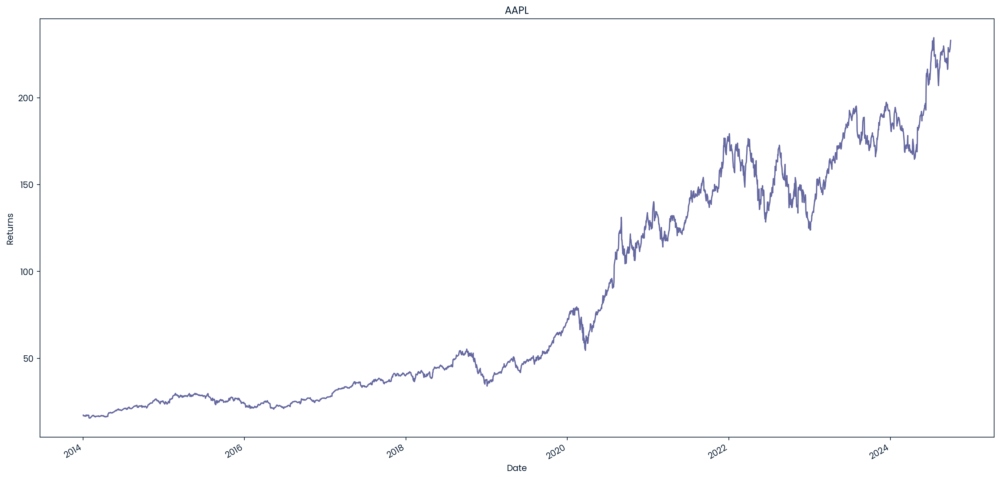

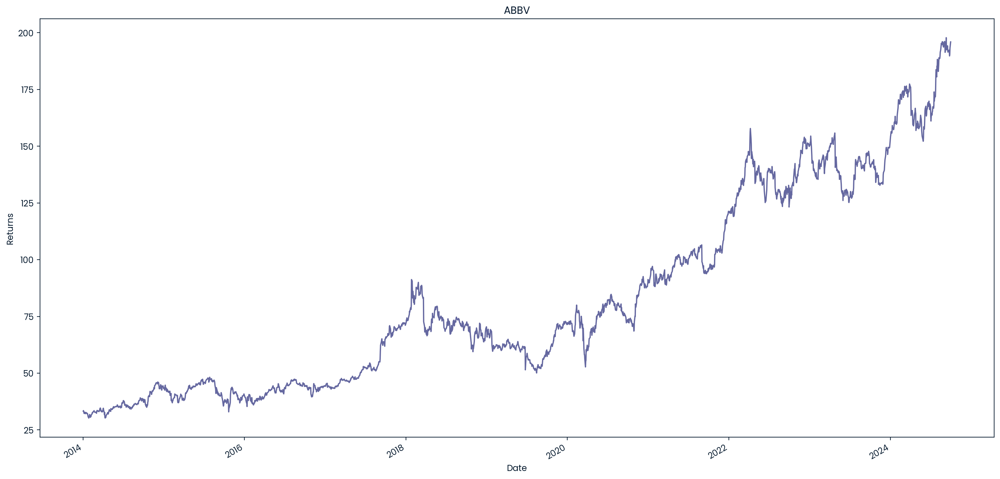

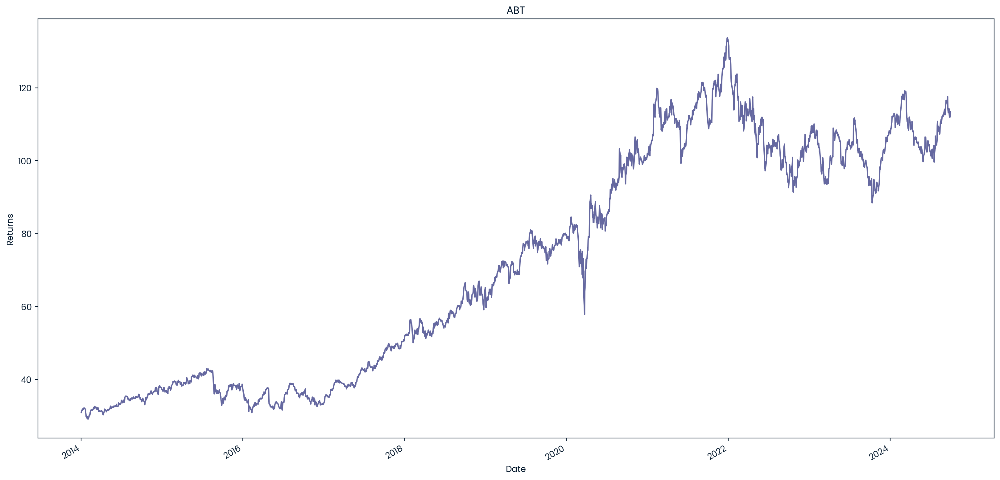

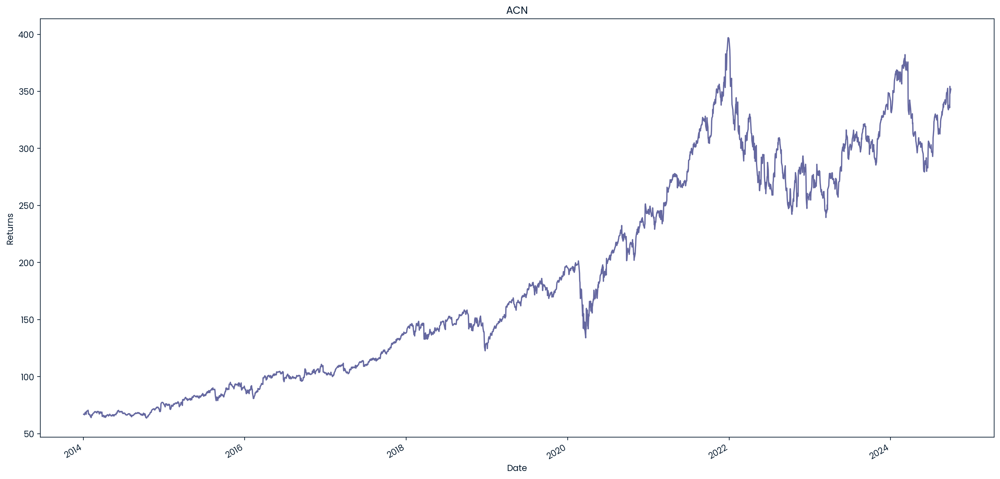

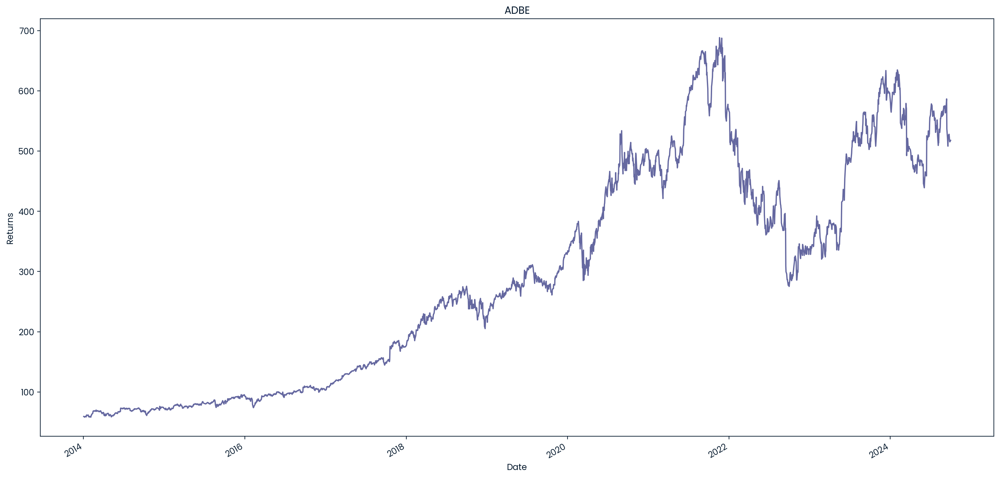

...

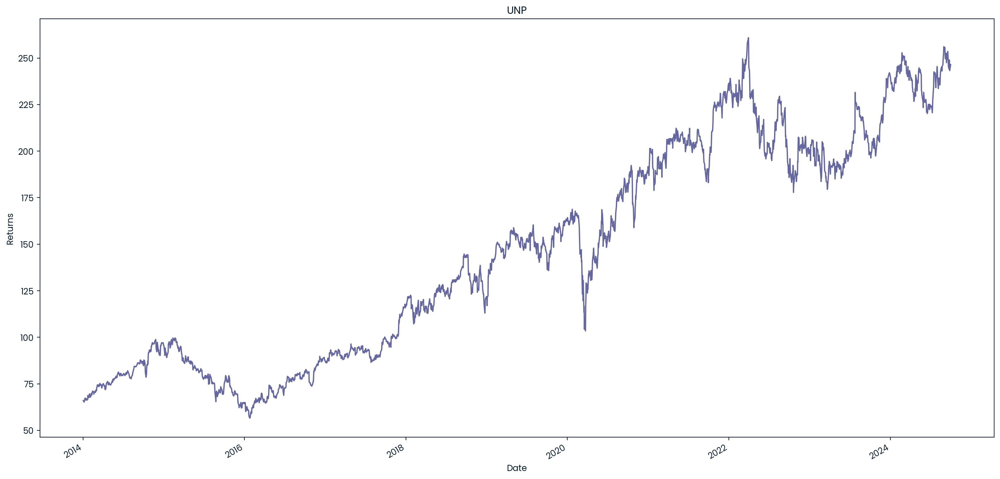

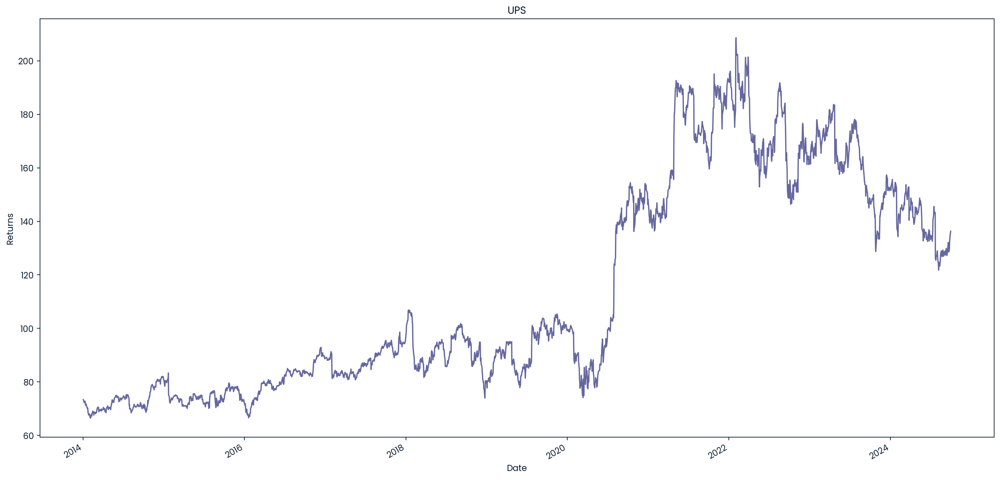

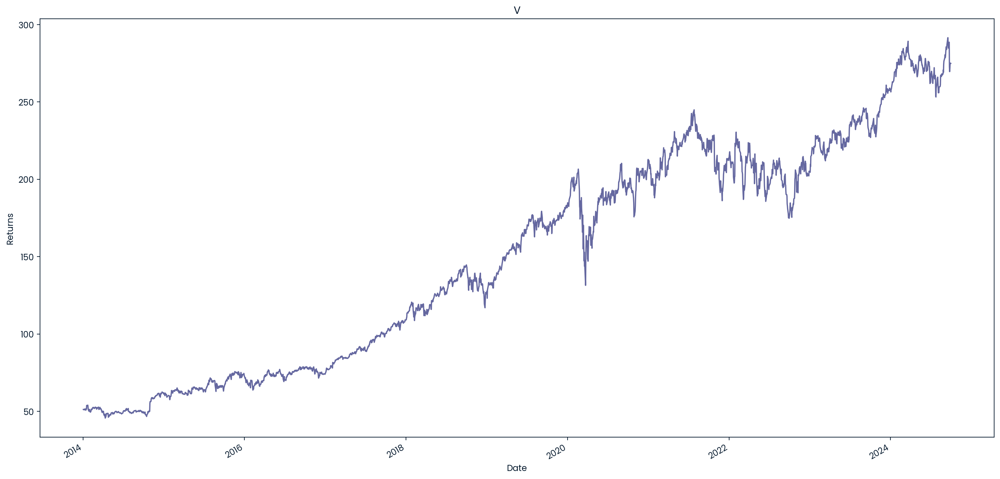

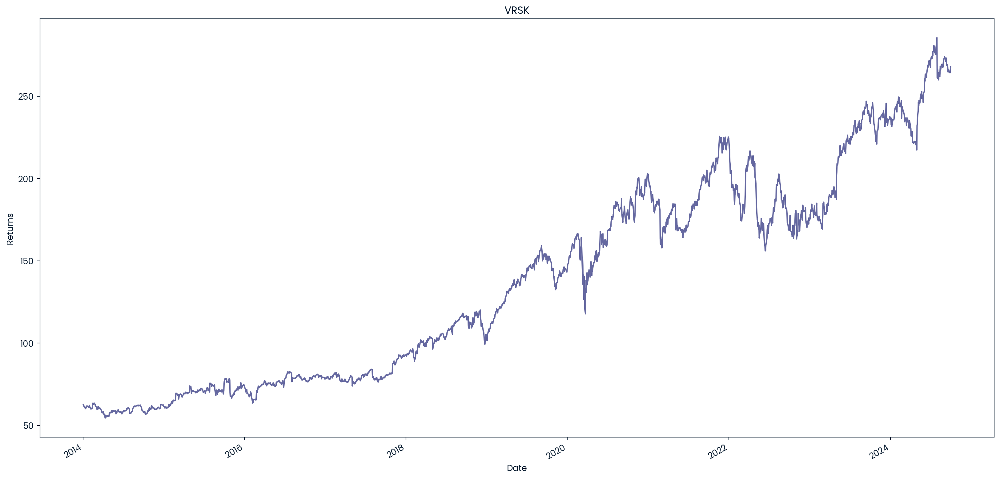

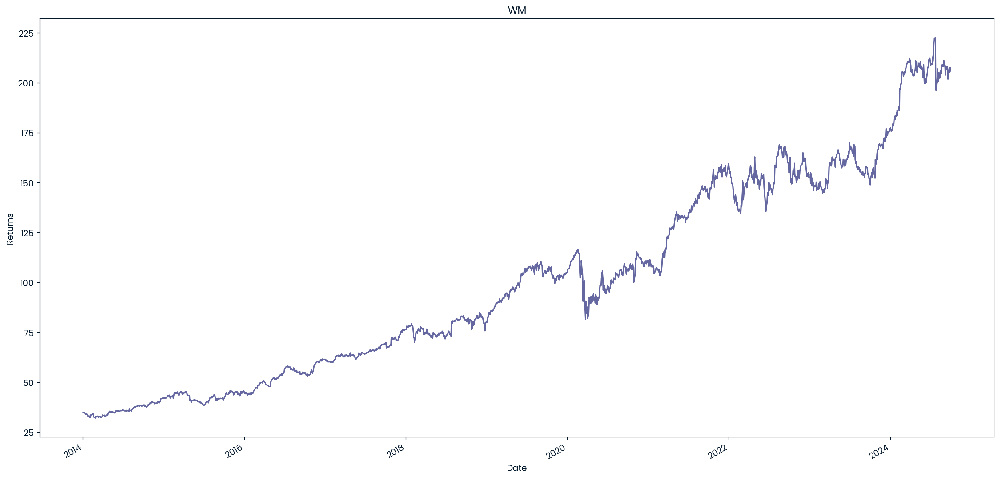

In [7]:
# function to download historical data
def get_data_absolute_returns(tickers, start, end):
    data_absolute = yf.download(tickers, start=start, end=end)['Adj Close']
    absolute_returns = data_absolute
    return absolute_returns

# Download data & get daily returns
absolute_returns = get_data_absolute_returns(tickers, start=start_date, end=end_date)
  
# show plots
for c in absolute_returns.columns:
    plt.plot()
    plt.title(c)
    plt.xlabel('Date')
    plt.ylabel('Returns')
    absolute_returns[c].plot(figsize=(20,10))
    plt.show()

<Axes: xlabel='Ticker', ylabel='Ticker'>

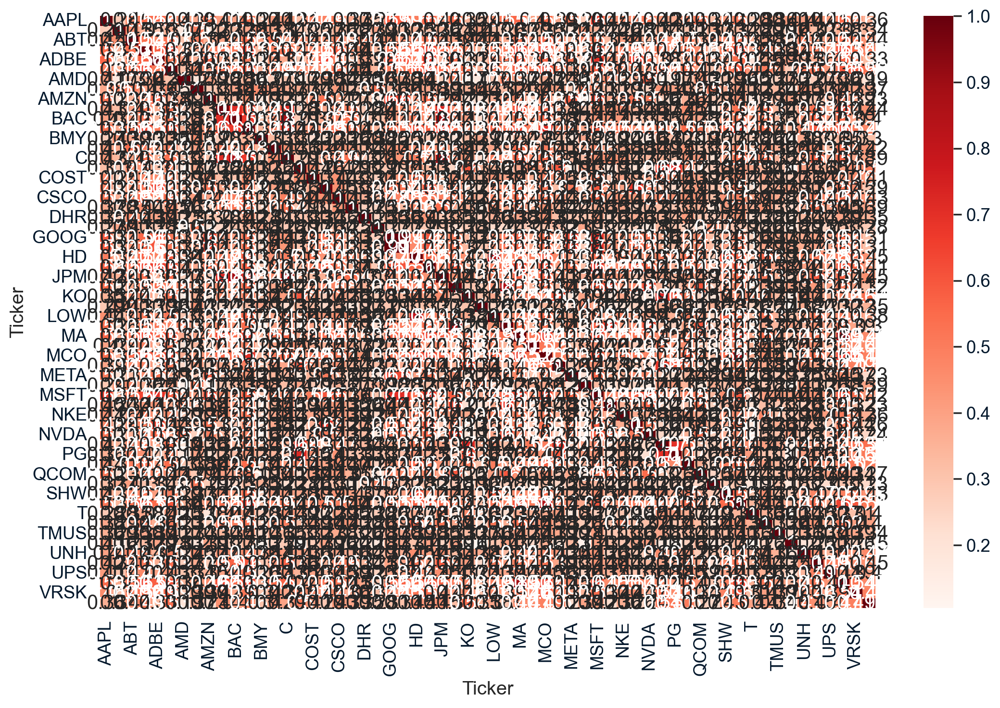

In [8]:
plt.figure(figsize=(13,8))
seaborn.set(font_scale=1.2)
seaborn.heatmap(returns.corr(),cmap="Reds", annot=True, annot_kws={"size":15})

In [9]:
# creating the hover_data dictionary dynamically
hover_data = {ticker: False for ticker in tickers}
hover_data.update({
    'Sharpe Ratio': True,
    'Volatility': True,
    'Return': True
})
# Plot with Plotly
fig = px.scatter(
    portfolio_results,
    x='Volatility',
    y='Return',
    color='Sharpe Ratio',
    color_continuous_scale='YlGnBu',
    labels={'Return': 'Monthly expected return', 'Volatility': 'Volatility (standard deviation)'},
    title='Efficient frontier',
    hover_data=hover_data,
)  
fig.show()

In [10]:
def find_optimal_portfolio(portfolio_results, target_volatility):
    # Filter the portfolios by target volatility, allowing for small tolerance (e.g., ±0.001)
    volatility_tolerance = 0.05  # Define tolerance level
    filtered_portfolios = portfolio_results[
        (portfolio_results['Volatility'] >= target_volatility - volatility_tolerance) & 
        (portfolio_results['Volatility'] <= target_volatility + volatility_tolerance)
    ]
    
    # Find the portfolio with the highest Sharpe ratio within the filtered set
    if not filtered_portfolios.empty:
        optimal_portfolio = filtered_portfolios.loc[filtered_portfolios['Sharpe Ratio'].idxmax()]
        return optimal_portfolio
    else:
        return "No portfolios found within the specified volatility range."

# Example usage:
target_volatility = 0.054  # Input your desired volatility value here
optimal_portfolio = find_optimal_portfolio(portfolio_results, target_volatility)

# Display the result
optimal_portfolio

Return          0.018773
Volatility      0.052098
Sharpe Ratio    0.360333
NVDA            0.018343
MSFT            0.025113
                  ...   
TJX             0.002115
C               0.009302
TMUS            0.006393
INTU            0.011985
AXP             0.030258
Name: 1610, Length: 63, dtype: float64

In [11]:
# Function to filter and rebalance portfolio weights
def filter_and_rebalance_weights(optimal_portfolio, weight_threshold):
    # Exclude the first 3 rows (Return, Volatility, Sharpe Ratio)
    asset_weights = optimal_portfolio[3:]
    
    # Filter out assets with weights below the threshold
    filtered_assets = asset_weights[asset_weights.iloc[:] >= weight_threshold]
    
    # Rebalance the remaining weights to sum to 1
    if not filtered_assets.empty:
        filtered_assets['Rebalanced Weight'] = filtered_assets.iloc[:] / filtered_assets.iloc[:].sum()
        return filtered_assets
    else:
        return "All weights are below the threshold"
    
weight_threshold = 0.005  # 0.5% threshold

# Apply the filtering and rebalancing function
rebalanced_portfolio = filter_and_rebalance_weights(optimal_portfolio, weight_threshold)

# Display the result
rebalanced_portfolio

NVDA                                                          0.018343
MSFT                                                          0.025113
AAPL                                                          0.017975
GOOGL                                                         0.022292
GOOG                                                          0.014143
AMZN                                                           0.00587
V                                                                 0.02
TSLA                                                          0.019595
META                                                          0.015812
MA                                                            0.023191
LLY                                                           0.018539
UNH                                                           0.014612
ABT                                                           0.024901
BAC                                                           0.017212
CRM   

**Strategy**

1. Use efficient frontier to find best performers on a risk aggiusted basis (the returns are computed on a monthly basis bc investment period is 1 month) as defined by the Sharpe Ratio
2. Data obtained from Yahoo Finance going from 01/01/2014 to last avaiable data in 2024
3. Selecting assets by capitalization, and reducing their # starting from smallest so that the minimum weight invested is not less than 500 UDS (making a fixed 10 USD fee about 2% of investment max)
4. Running X simulations giving random weights to assets
5. Select an appropriate risk level (defined by sd) and finding the highest Sharpe

Rebalance every week

Implementing strategy on Howmarketwork.com by investing the 100000 USD in ESG stocks